# Forecast Household Energy Consumption 


The project consists of the following:

1. Introduction

     1.1 Importing Libraries And Data   
<br/> 

2. Visualization Of Time Series

     2.1 Prepare Data For Time Series Analysis

     2.2 Exploratory Data Analysis

     2.3 Decomposition     
<br/>  


3. Time Series Forecasting 

     3.1 Time Series Linear Regression

     3.2 Compare Results With Auto-ARIMA

     3.3 Holt-Winters Exponential Smoothing   
<br/>  


4. Recommendations For Smart Home Builders
<br/> 


## 1. Introduction

A regional home developer is looking to develop analytics for a new set of electrical sub-metering devices used for power management in smart homes. Installing these sub-meters could be a big step towards the developer's goal of offering highly efficient smart homes that provide owners with power usage analytics.
<br/>

We're provided with a very large data set that contains 47 months of energy usage data from these devices. Our goal is to analyze this data to determine what kind of analytics and visualizations can be created that would empower smart home owners with greater understanding and control of their power usage. 
<br/>

In this project, we will begin by exploring some visualizations of the data and then build predictive models that will demonstrate to our client how the data can be used to help a home owner to make decisions about altering power consumption. 
<br/>

### 1.1 Importing Libraries And Data

In [15]:
# Load libraries
library(lubridate)
library(pastecs)
library(parallel)
library(doParallel)
library(dplyr)
library(foreach)
library(iterators)

library(ggplot2)
library(ggfortify)
library(plotly)

cl <- makeCluster(6)
registerDoParallel(cl)
getDoParWorkers()

options(warn=-1)

[1] 6

In [3]:
# Load data
household_power_consumption <- read.csv('C:/Users/Noxar/Desktop/Household Energy Consumption/household_power_consumption.txt', sep =';', header = 1)

In [4]:
# Check missing values
sum(is.na(household_power_consumption))
df <- na.omit(household_power_consumption)

[1] 25979

## 2. Visualization Of Time Series

### 2.1 Prepare Data For Time Series Analysis

In [5]:
# Combine Date and Time attribute values in a new attribute column
df<-cbind(df,paste(df$Date,df$Time), stringsAsFactors=FALSE)
colnames(df)[10] <-"DateTime"
df$DateTime<- as.character(df$DateTime, format = "%d/%m/%Y %H:%M:%S")

# Convert DateTime from character to POSIXct
df$DateTime <- as.POSIXct(df$DateTime, format = "%d/%m/%Y %H:%M:%S")

In [7]:
# Create time zone
attr(df$DateTime, "tzone") <- "Europe/Paris"

In [8]:
# Create columns of year, month, quarter, week, day, hour and minute 
df$year <- year(df$DateTime)
df$quarter <- quarter(df$DateTime)
df$month <- month(df$DateTime)
df$week <- week(df$DateTime)
df$weekDay <- weekdays(df$DateTime)
df$day <- day(df$DateTime)
df$hour <- hour(df$DateTime)
df$minute <- minute(df$DateTime)

In [9]:
# Convert variables to numeric variables
df$Global_active_power<- as.numeric(df$Global_active_power)
df$Global_reactive_power<- as.numeric(df$Global_reactive_power)
df$Voltage<- as.numeric(df$Voltage)
df$Global_intensity<- as.numeric(df$Global_intensity)
df$Sub_metering_1<- as.numeric(df$Sub_metering_1)
df$Sub_metering_2<- as.numeric(df$Sub_metering_2)

### 2.2 Exploratory Data Analysis

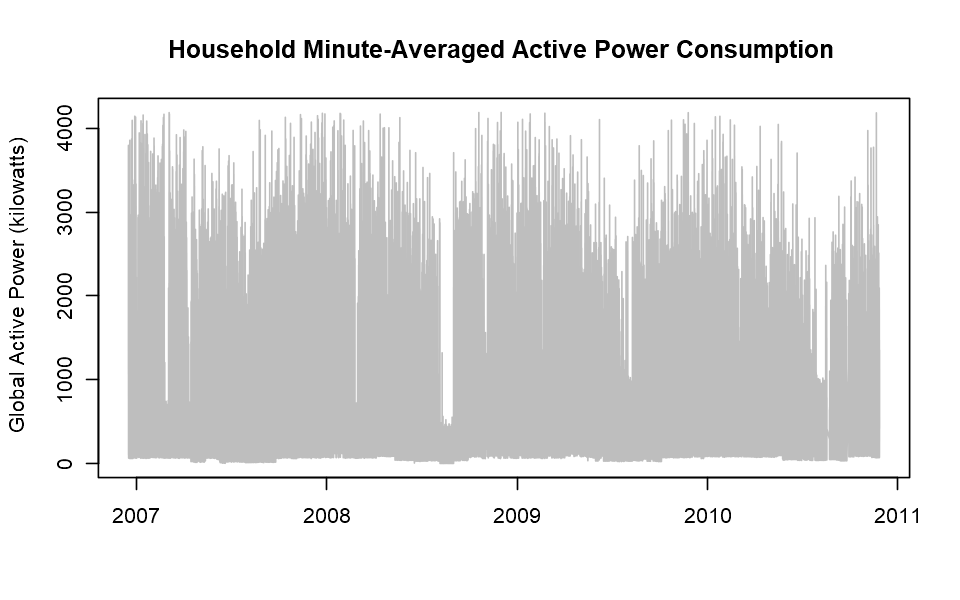

In [10]:
# Plot global active power consumption
library(repr)
options(repr.plot.width=8, repr.plot.height=5)
plot(df$DateTime, df$Global_active_power, type="l", xlab="", ylab="Global Active Power (kilowatts)", col="gray", main="Household Minute-Averaged Active Power Consumption ")

In [12]:
# Rename sub-metering columns for better visualization 
colnames(df)[7]<-"Kitchen"
colnames(df)[8]<-"Laundry_room"
colnames(df)[9]<-"Water_heater_ac"

In [16]:
## Reduce Granularity- Subset Jan 9th 2008 with 10 Minute frequency
houseDay10 <- filter(df, year == 2008 & month == 1 & day == 9 & (minute == 0 | minute == 10 | minute == 20 | minute == 30 | minute == 40 | minute == 50))

plot_ly(houseDay10, x = ~houseDay10$DateTime, y = ~houseDay10$Kitchen, name = 'Kitchen', type = 'scatter', mode = 'lines') %>%
 add_trace(y = ~houseDay10$Laundry_room, name = 'Laundry Room', mode = 'lines') %>%
 add_trace(y = ~houseDay10$Water_heater_ac, name = 'Water Heater & AC', mode = 'lines') %>%
 layout(title = "Power Consumption January 9th, 2008",
 xaxis = list(title = "Time"),
 yaxis = list (title = "Power (watt-hours)"))

HTML widgets cannot be represented in plain text (need html)

We can see there's a spike of kitchen usage in the early morning before 6 am and then it remains low throughout the day. Energy usage of laundry room has intervals of every 2 hours. Usage of water heater and AC has peaks around 6am, between 2pm to 9pm and another peak after mid-night.    

In [17]:
## Subset the second week of Jan 2008 
houseWeek <- filter(df, year == 2008 & month == 1 & week == 2)

plot_ly(houseWeek, x = ~houseWeek$DateTime, y = ~houseWeek$Kitchen, name = 'Kitchen', type = 'scatter', mode = 'lines') %>%
 add_trace(y = ~houseWeek$Laundry_room, name = 'Laundry Room', mode = 'lines') %>%
 add_trace(y = ~houseWeek$Water_heater_ac, name = 'Water Heater & AC', mode = 'lines') %>%
 layout(title = "Weekly Power Consumption",
 xaxis = list(title = "Time"),
 yaxis = list (title = "Power (watt-hours)"))

HTML widgets cannot be represented in plain text (need html)

The power consumption of kitchen has a spike every day and only during certain hours. Kitchen is heavily used especially on Sunday. The usage of laundry room has regular intervals with two peaks, one in the middle of the week and the other on the weekend. The power consumption of water-heater and AC is evenly distributed through out the week, with a few cycles during the day and at a constant level.        

In [18]:
sum1 <- sum(df$Kitchen, na.rm = FALSE)
sum2 <- sum(df$Laundry_room, na.rm = FALSE)
sum3 <- sum(df$Water_heater_ac, na.rm = FALSE)
Sum = c(sum1, sum2, sum3)
Sub_metering = c("Kitchen", "Laundry_room", "Water_heater_ac")

plot_ly(df, labels = ~Sub_metering, values = ~Sum, type = 'pie') %>%
  layout(title = 'Total Household Power Consumption',
         xaxis = list(showgrid = FALSE, zeroline = FALSE, showticklabels = FALSE),
         yaxis = list(showgrid = FALSE, zeroline = FALSE, showticklabels = FALSE))

HTML widgets cannot be represented in plain text (need html)

From 2007-2010, water heater and AC accounted for the majority of power consumption in the household, followed by laundry room. People consume the least energy in the kitchen.  

In [44]:
houseDay <- filter(df, year == 2008 & month == 1 & day == 9) 
sum1 <- sum(houseDay$Kitchen, na.rm = FALSE)
sum2 <- sum(houseDay$Laundry_room, na.rm = FALSE)
sum3 <- sum(houseDay$Water_heater_ac, na.rm = FALSE)
Sum = c(sum1, sum2, sum3)
Sub_metering = c("Kitchen", "Laundry_room", "Water_heater_ac")

plot_ly(houseDay, labels = ~Sub_metering, values = ~Sum, type = 'pie') %>%
  layout(title = 'Daily Household Power Consumption-January 9th, 2008',
         xaxis = list(showgrid = FALSE, zeroline = FALSE, showticklabels = FALSE),
         yaxis = list(showgrid = FALSE, zeroline = FALSE, showticklabels = FALSE))

HTML widgets cannot be represented in plain text (need html)

We selected Jan 9th for daily observation and it shows that more than half of the household power is used by water heater and AC. Laundry room uses slightly more energy than kitchen. 

In [45]:
house07 <- filter(df, year == "2007")
house08 <- filter(df, year == "2008")
house09 <- filter(df, year == "2009")
house10 <- filter(df, year == "2010")

sum_07_1 <- sum(house07$Kitchen, na.rm = FALSE)
sum_07_2 <- sum(house07$Laundry_room, na.rm = FALSE)
sum_07_3 <- sum(house07$Water_heater_ac, na.rm = FALSE)
Sum_07 = c(sum_07_1, sum_07_2, sum_07_3)

sum_08_1 <- sum(house08$Kitchen, na.rm = FALSE)
sum_08_2 <- sum(house08$Laundry_room, na.rm = FALSE)
sum_08_3 <- sum(house08$Water_heater_ac, na.rm = FALSE)
Sum_08 = c(sum_08_1, sum_08_2, sum_08_3)

sum_09_1 <- sum(house09$Kitchen, na.rm = FALSE)
sum_09_2 <- sum(house09$Laundry_room, na.rm = FALSE)
sum_09_3 <- sum(house09$Water_heater_ac, na.rm = FALSE)
Sum_09 = c(sum_09_1, sum_09_2, sum_09_3)

sum_10_1 <- sum(house10$Kitchen, na.rm = FALSE)
sum_10_2 <- sum(house10$Laundry_room, na.rm = FALSE)
sum_10_3 <- sum(house10$Water_heater_ac, na.rm = FALSE)
Sum_10 = c(sum_10_1, sum_10_2, sum_10_3)

Sub_metering = c("Kitchen", "Laundry_room", "Water_heater_ac")

plot_ly() %>%
  add_pie(data = house07, labels = ~Sub_metering, values = ~Sum_07,
          title = "2007", domain = list(row = 0, column = 0)) %>%
  add_pie(data = house08, labels = ~Sub_metering, values = ~Sum_08,
          title = "2008", domain = list(row = 0, column = 1)) %>%
  add_pie(data = house09, labels = ~Sub_metering, values = ~Sum_09,
          title = "2009", domain = list(row = 1, column = 0)) %>%
  add_pie(data = house10, labels = ~Sub_metering, values = ~Sum_10,
          title = "2010", domain = list(row = 1, column = 1)) %>%
  layout(title = "Power Consumption by Year", showlegend = F,
         grid=list(rows=2, columns=2),
         xaxis = list(showgrid = FALSE, zeroline = FALSE, showticklabels = FALSE),
         yaxis = list(showgrid = FALSE, zeroline = FALSE, showticklabels = FALSE))

HTML widgets cannot be represented in plain text (need html)

Energy used by water heater and AC has increased every year from 2007-2010, whereas energy used by laundry room and kitchen has gradually decreased. 

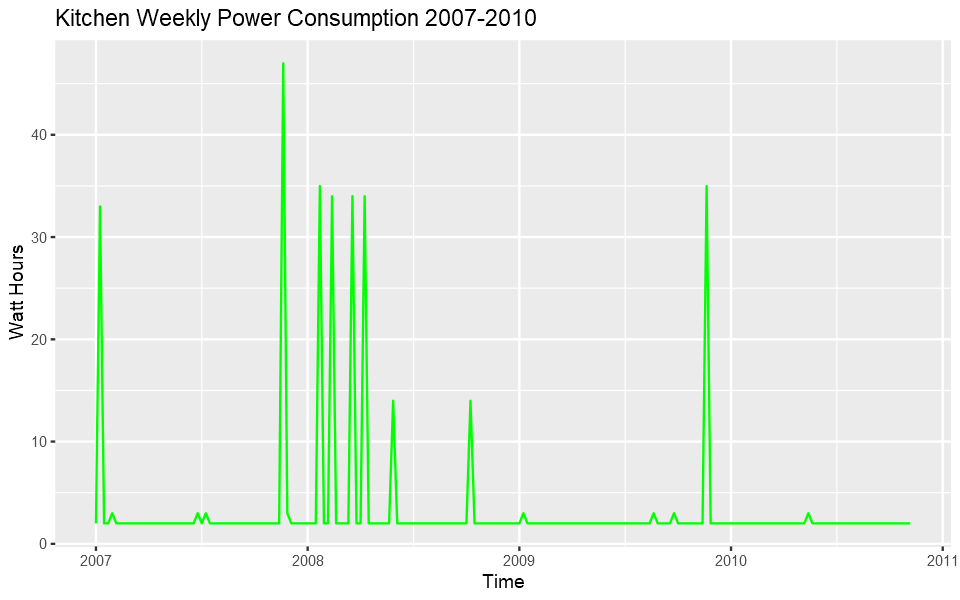

In [23]:
## Subset to one observation per week on Sundays at 10am 2007-2010
SM1_weekly <- filter(df, weekDay == "Sunday"& hour == 10 & minute == 1)
tsSM1_weekly <- ts(SM1_weekly$Kitchen, frequency=52, start=c(2007,1))
autoplot(tsSM1_weekly, ts.colour = 'green', xlab = "Time", ylab = "Watt Hours", main = "Kitchen Weekly Power Consumption 2007-2010")

Kitchen power consumptions are more frequent in 2008 than any other year. The peak starts at the end of 2007 and continues to mid 2008. 

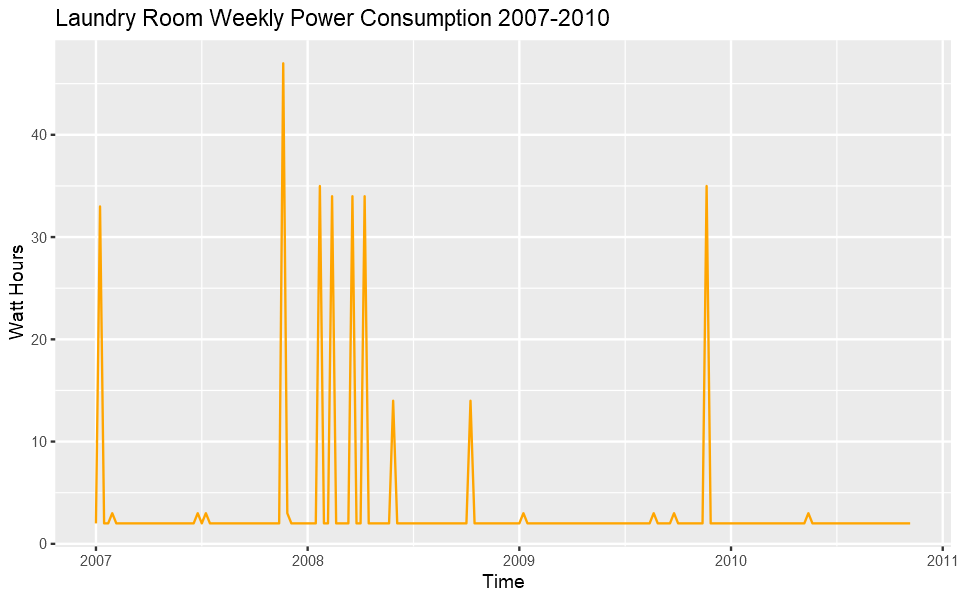

In [25]:
## Subset to one observation per week on Sundays at 11pm 2007-2010
SM2_weekly <- filter(df, weekDay == "Sunday"& hour == 23 & minute == 1)
tsSM2_weekly <- ts(SM2_weekly$Laundry_room, frequency=52, start=c(2007,1))
autoplot(tsSM1_weekly, ts.colour = 'orange', xlab = "Time", ylab = "Watt Hours", main = "Laundry Room Weekly Power Consumption 2007-2010")

Laundry room power consumption follows the same pattern as kitchen usage, with spikes starting end of 2007 and ending in summer 2008. This could be due to the Energy Star Campaign in fall 2008, which encourages Americans to save energy at home and at work.   

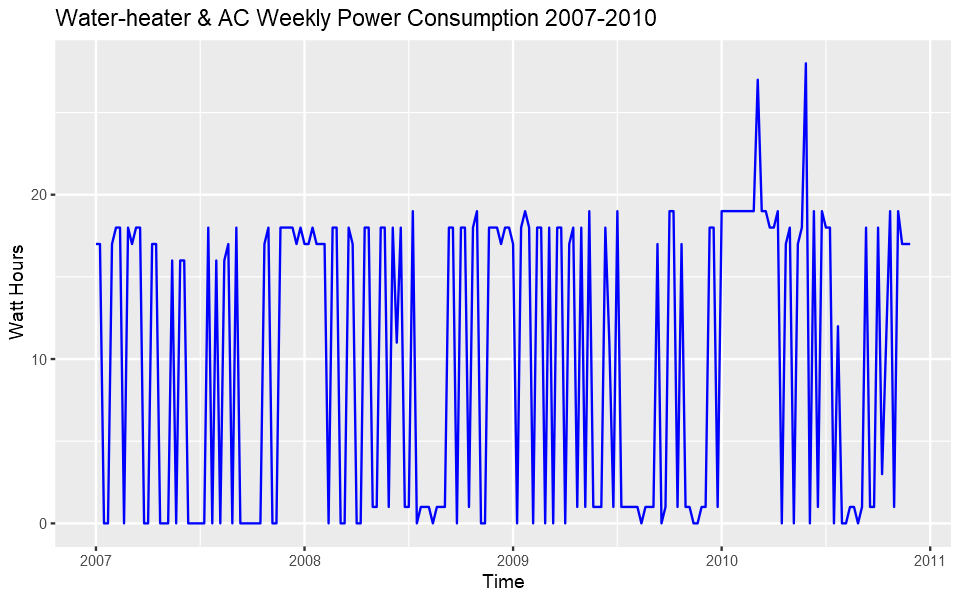

In [26]:
## Subset to one onservation per week on Mondays at 8:00pm for 2007-2010
SM3_weekly <- filter(df, weekDay == "Monday" & hour == 20 & minute == 1)
tsSM3_weekly <- ts(SM3_weekly$Water_heater_ac, frequency=52, start=c(2007,1))
autoplot(tsSM3_weekly, ts.colour = 'blue', xlab = "Time", ylab = "Watt Hours", main = "Water-heater & AC Weekly Power Consumption 2007-2010")

Water-heater and AC power usage doesn't fluctuate much from 2007 to 2010 in terms of intensity and frequency. 

### 2.3 Decomposition Of Seasonal Time Series

A seasonal time series consists of a trend component, a seasonal component and an irregular component. Decomposing the time series means separating the time series into these three components so we can analyze the trend of a time series independently of the seasonal components.

In [27]:
my_plot.decomposed.ts = function(x, title="", ...) {
  xx <- x$x
  if (is.null(xx)) 
    xx <- with(x, if (type == "additive") 
      random + trend + seasonal
      else random * trend * seasonal)
  plot(cbind(observed = xx, trend = x$trend, seasonal = x$seasonal, random = x$random), 
       main=title, ...)
}

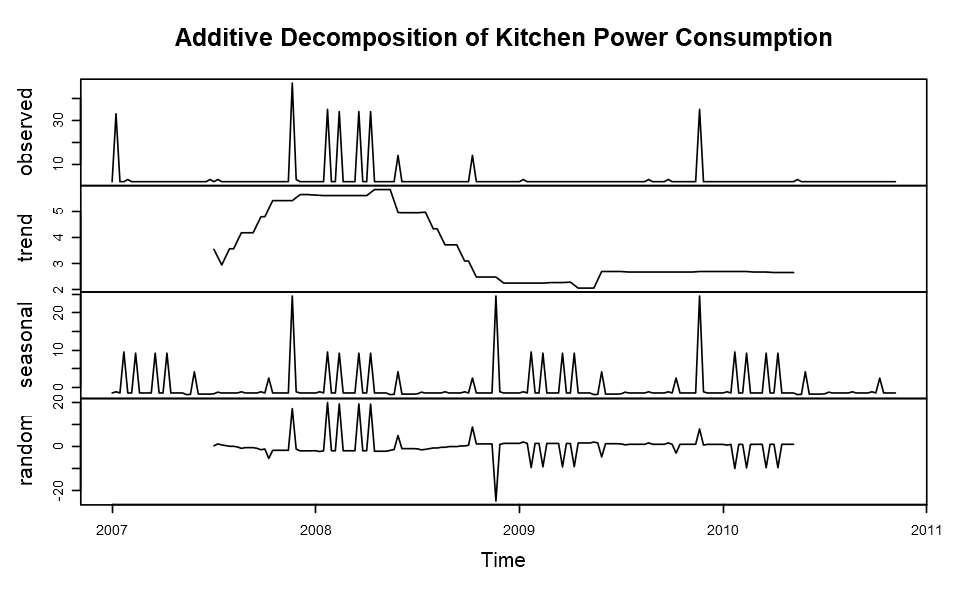

In [28]:
componentsSM1weekly <- decompose(tsSM1_weekly)
my_plot.decomposed.ts(componentsSM1weekly, "Additive Decomposition of Kitchen Power Consumption")

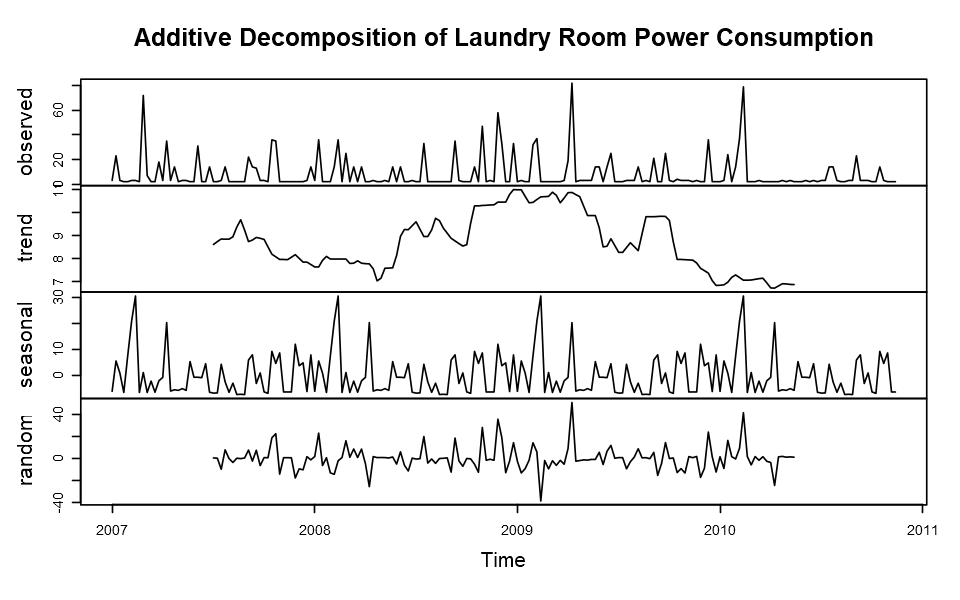

In [29]:
componentsSM2weekly <- decompose(tsSM2_weekly)
my_plot.decomposed.ts(componentsSM2weekly, "Additive Decomposition of Laundry Room Power Consumption")

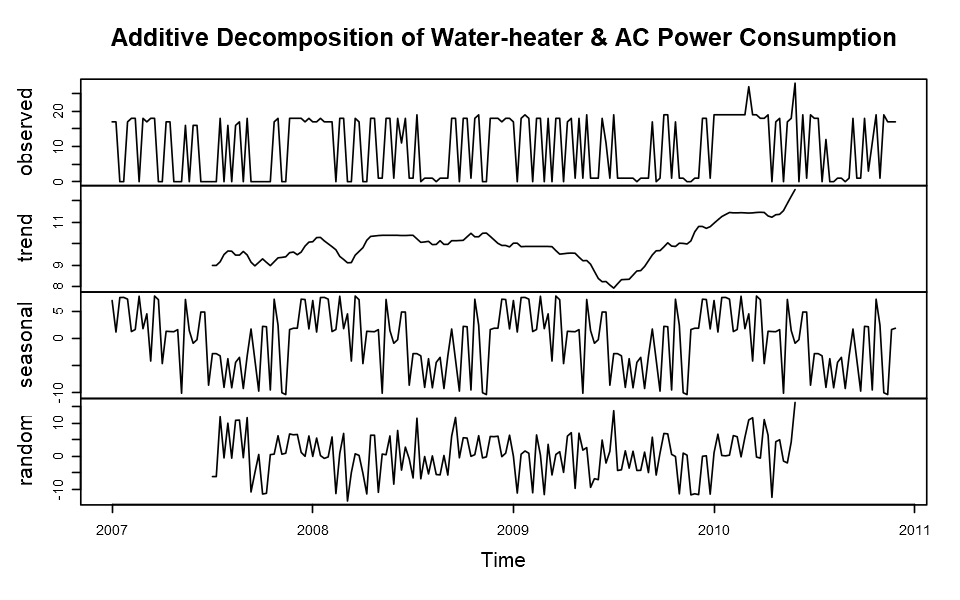

In [30]:
## Decomposition of additive time series
componentsSM3weekly <- decompose(tsSM3_weekly)
my_plot.decomposed.ts(componentsSM3weekly, "Additive Decomposition of Water-heater & AC Power Consumption")

##### Summary of findings:

- All three sub-meterings have obvious seasonal trends but no significant overall upward or downward trend. 
<br />
- ##### Kitchen:
Power uage has an upward trend since the third quarter of 2007 and then starts to drop in the second quarter of 2008, which seems to coincide with the timeline of Star energy saving campaign. There's obvious seasonality where the usage is low throughout summer and fall and peaks at the end of the year, which might be due to the holidays.
<br />
- ##### Laundry room: 
Power usage significantly increased in 2008 and starts to decrease in the second quarter of 2009. The first peak is in the beginning of the year, followed by the second peak in the beginning of spring.
<br />
- ##### Water-heater and AC: 
The usage doesn't have much fluctuation until the second quarter of 2009; it drops to the lowest point in summer 2009 and starts an upward trend. It shows a seasonl trend where the consumption is lower in summer, which might be due to the fact that people ususally spend less time at home during summer. 
<br />

## 3. Time Series Forecasting

### 3.1 Time Series Linear Regression 

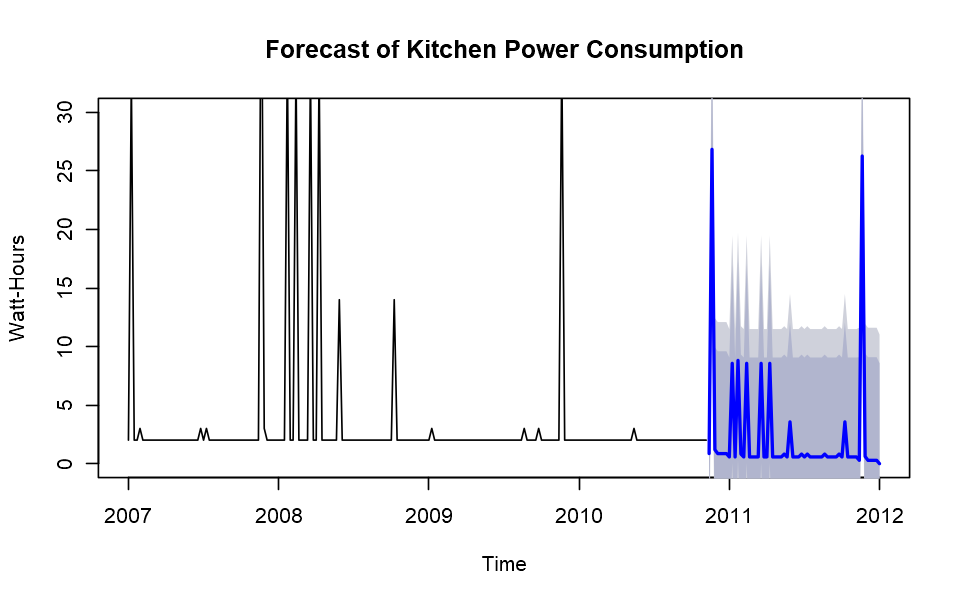

In [38]:
## Create forecast with time series linear regression 
library(forecast)
fitSM1 <- tslm(tsSM1_weekly ~ trend + season)
forecastfitSM1c <- forecast(fitSM1, h=60, level=c(80,90))
plot(forecastfitSM1c, ylim = c(0, 30), ylab= "Watt-Hours", xlab="Time", main="Forecast of Kitchen Power Consumption")

Kitchen power usage is predicted to have a spike during year-end, higher frequency and watt-hour during winter and spring, and remains low through summer and fall. People use the kitchen significantly more during the holidays, and they spend less time cooking in summer.

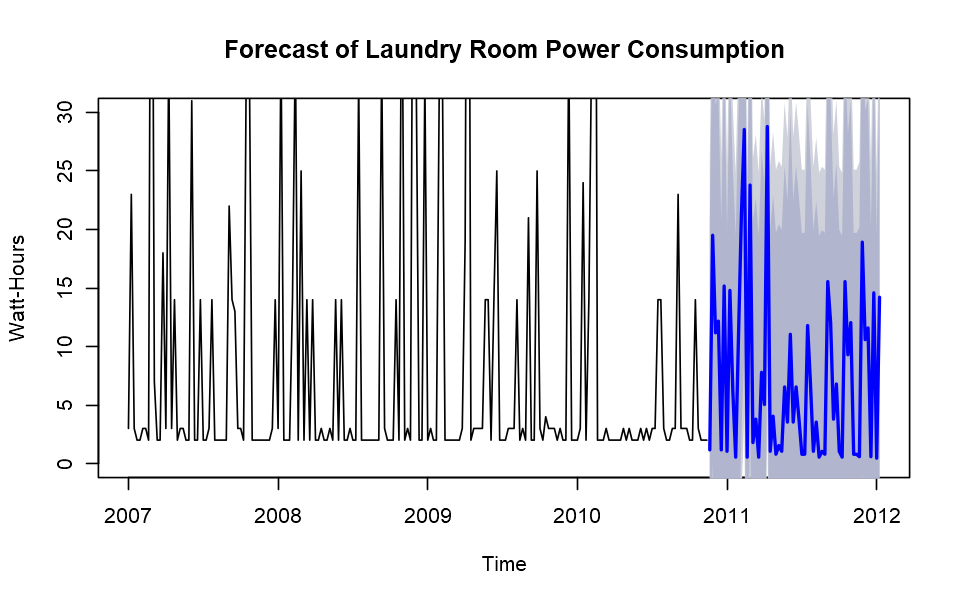

In [37]:
fitSM2 <- tslm(tsSM2_weekly ~ trend + season)
forecastfitSM2c <- forecast(fitSM2, h=60, level=c(80,90))
plot(forecastfitSM2c, ylim = c(0, 30), ylab= "Watt-Hours", xlab="Time", main="Forecast of Laundry Room Power Consumption")

Predicted power consumption of laundry room has the same pattern as power consumption of kitchen, that is, more usage in winter/spring and less usage in summer/fall. But it has higher frequency and higher watt per hour, with a few spikes in the beginning of spring. It shows that people use laundry room the most during the transition from winter to spring.

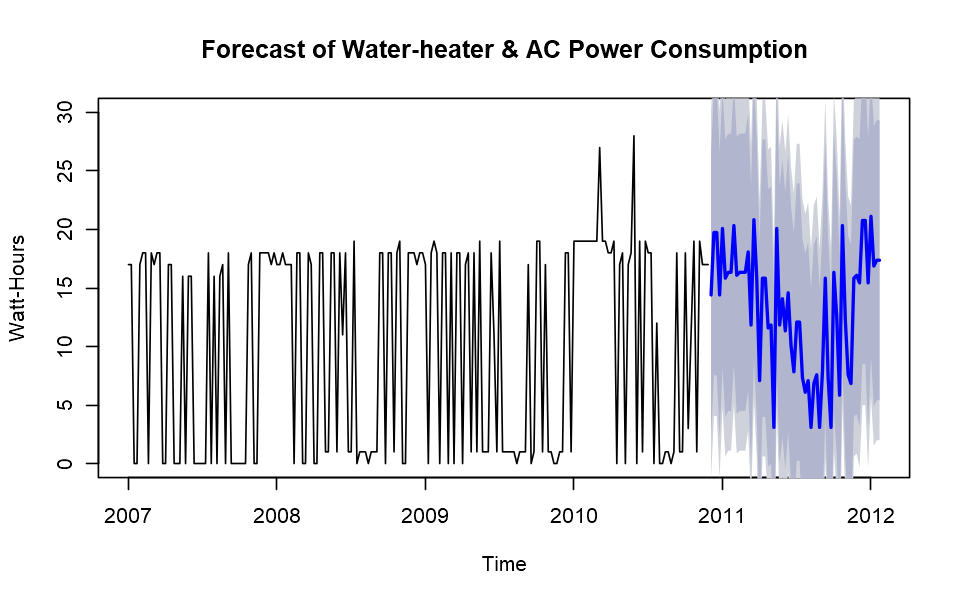

In [39]:
fitSM3 <- tslm(tsSM3_weekly ~ trend + season) 
forecastfitSM3c <- forecast(fitSM3, h=60, level=c(80,90))
plot(forecastfitSM3c, ylim = c(0, 30), ylab= "Watt-Hours", xlab="Time", main="Forecast of Water-heater & AC Power Consumption")

Forecast of water-heater/AC usage doesn't have significant spikes, but the usage is the highest in winter, followed by spring and fall, and is the lowest in summer.   

### 3.2 Compare Results With Auto ARIMA

In [42]:
## Create forecast with auto ARIMA
arimaSM1 <- auto.arima(tsSM1_weekly)
forecastArimaSM1c <- forecast(arimaSM1, h=60, level=c(80,90))

arimaSM2 <- auto.arima(tsSM2_weekly)
forecastArimaSM2c <- forecast(arimaSM2, h=60, level=c(80,90))

arimaSM3 <- auto.arima(tsSM3_weekly)
forecastArimaSM3c <- forecast(arimaSM3, h=60, level=c(80,90))

In [43]:
## Compare the accuracy of ts linear regression and Arima 
accuracy(forecastfitSM1c)
accuracy(forecastArimaSM1c)

accuracy(forecastfitSM2c)
accuracy(forecastArimaSM2c)

accuracy(forecastfitSM3c)
accuracy(forecastArimaSM3c)

,ME,RMSE,MAE,MPE,MAPE,MASE,ACF1
Training set,-1.78451e-17,5.014809,2.070595,-37.17423,65.18618,0.7242223,-0.01371933


,ME,RMSE,MAE,MPE,MAPE,MASE,ACF1
Training set,-0.1206673,6.186754,2.496048,-55.8174,73.22617,0.873031,-0.005745007


,ME,RMSE,MAE,MPE,MAPE,MASE,ACF1
Training set,-2.673712e-16,11.16812,6.644614,-129.5479,160.8051,0.6518588,0.09342992


,ME,RMSE,MAE,MPE,MAPE,MASE,ACF1
Training set,-4.199713e-12,13.42127,9.084502,-190.6524,219.5875,0.8912199,0.06352079


,ME,RMSE,MAE,MPE,MAPE,MASE,ACF1
Training set,-9.224594e-17,7.013162,5.705471,NaN,Inf,0.7826999,0.01727761


,ME,RMSE,MAE,MPE,MAPE,MASE,ACF1
Training set,0.03256832,8.061982,7.356816,-Inf,Inf,1.009238,-0.0007857089


It shows forecasts with time series linear regression model has lower scores in all matrics than auto arima model, indicating that it's a better model to predict power consumptions of kitchen, laundry room and water heater/ac.  

### 3.3 Holt Winters Exponential Smoothing

Holt Winters Exponential smoothing is to smooth the original univariate series and to use the smoothed series in forecasting future values. 
It assigns exponentially decreasing weights and values against historical data to decrease the value of the weight for the older data. More recent historical data is assigned more weight in forecasting than the older results. 
<br /><br />
To use Holt-Winters forecasting, we will first need to remove the seasonal component that we identified in decomposition.

#### 3.3.1 Remove Seasonal Components

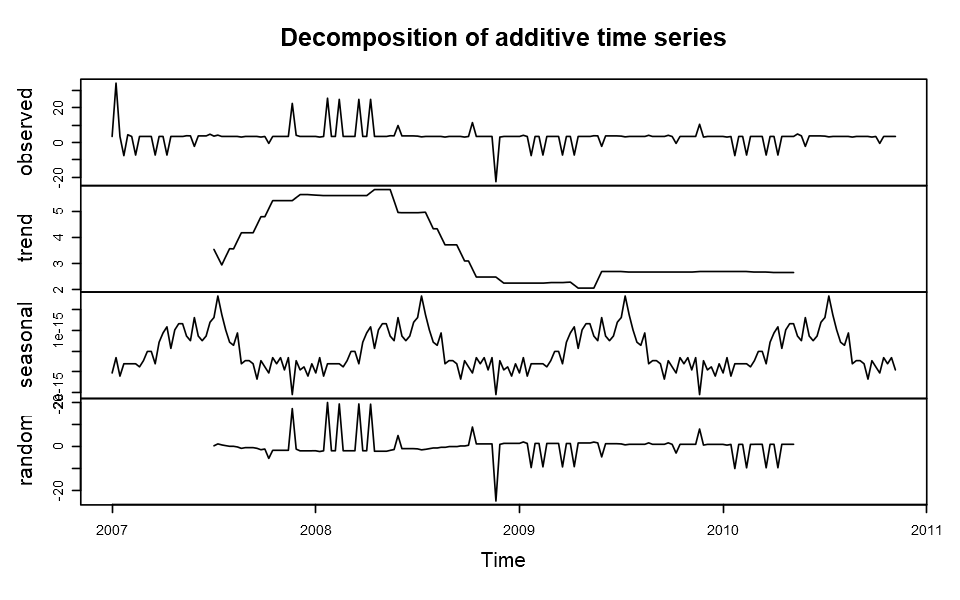

In [64]:
## Seasonal adjusting kitchen by subtracting the seasonal component
library(stats)
tsSM1_Adjusted <- tsSM1_weekly - componentsSM1weekly$seasonal

## Test Seasonal Adjustment by running Decompose again. Note the very, very small scale for Seasonal
plot(decompose(tsSM1_Adjusted))

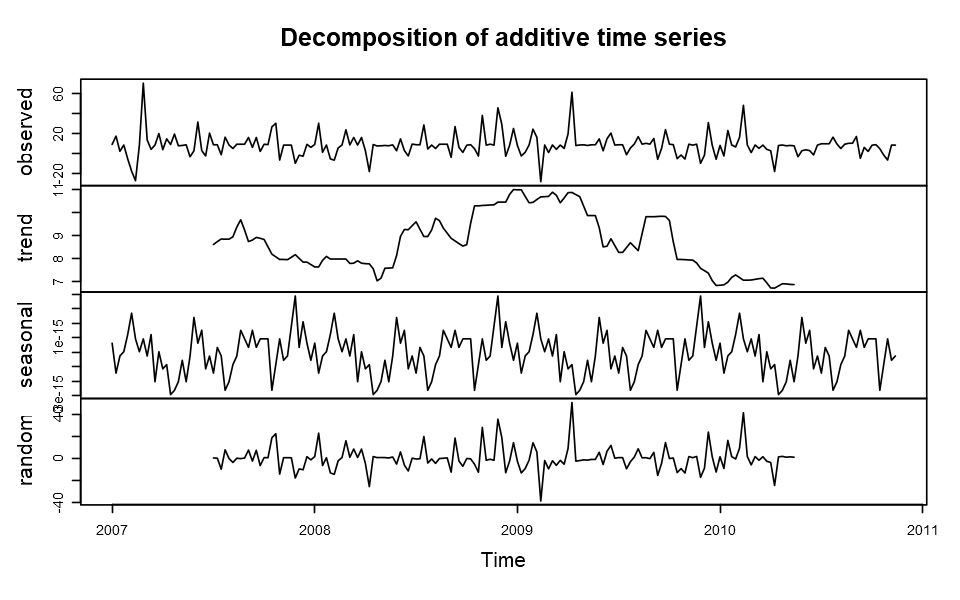

In [65]:
## Seasonal adjusting laundry room by subtracting the seasonal component
tsSM2_Adjusted <- tsSM2_weekly - componentsSM2weekly$seasonal
plot(decompose(tsSM2_Adjusted))

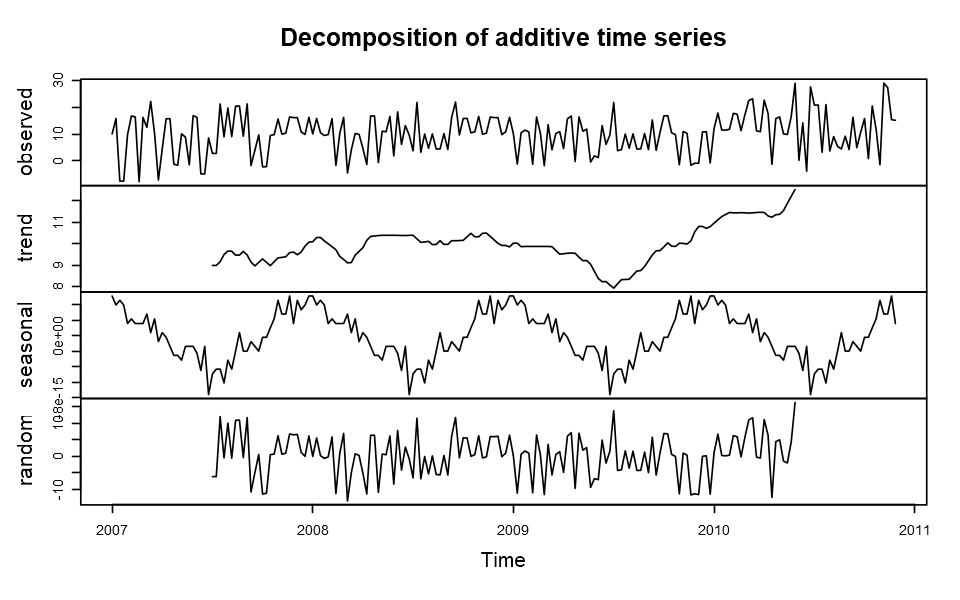

In [66]:
## Seasonal adjusting water-heater and AC by subtracting the seasonal component
tsSM3_Adjusted <- tsSM3_weekly - componentsSM3weekly$seasonal
plot(decompose(tsSM3_Adjusted))

We can see there is a seasonal line, but if we look at the scale for the seasonal section, -1e-15 through 5e-16. That's a decimal with 15 zeros before 1. A very very small number indeed. For all practical purposes the seasonality has been removed. 

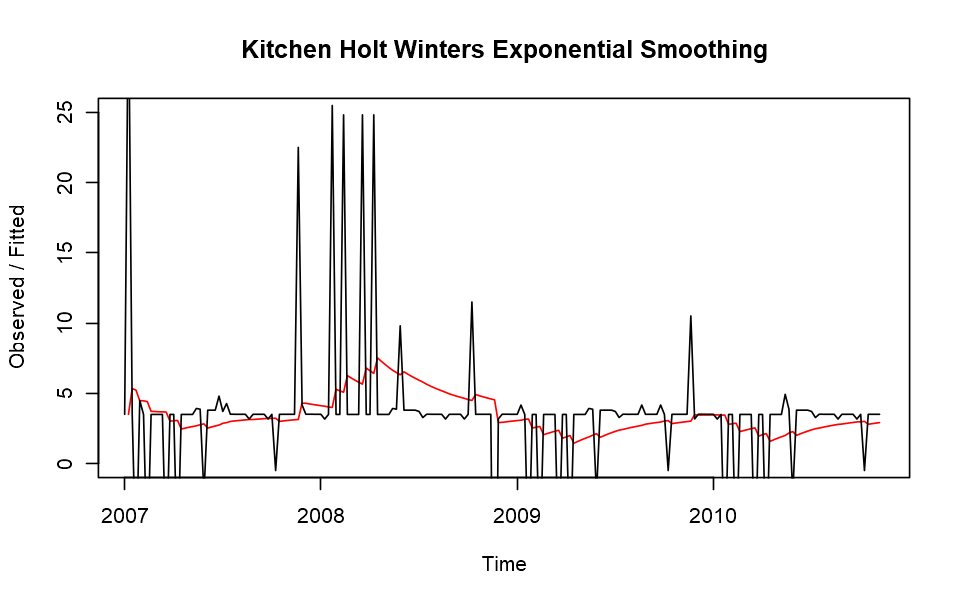

In [55]:
## Holt Winters Exponential Smoothing 
tsSM1_HW <- HoltWinters(tsSM1_Adjusted, beta=FALSE, gamma=FALSE)
plot(tsSM1_HW, ylim = c(0, 25), main ="Kitchen Holt Winters Exponential Smoothing")

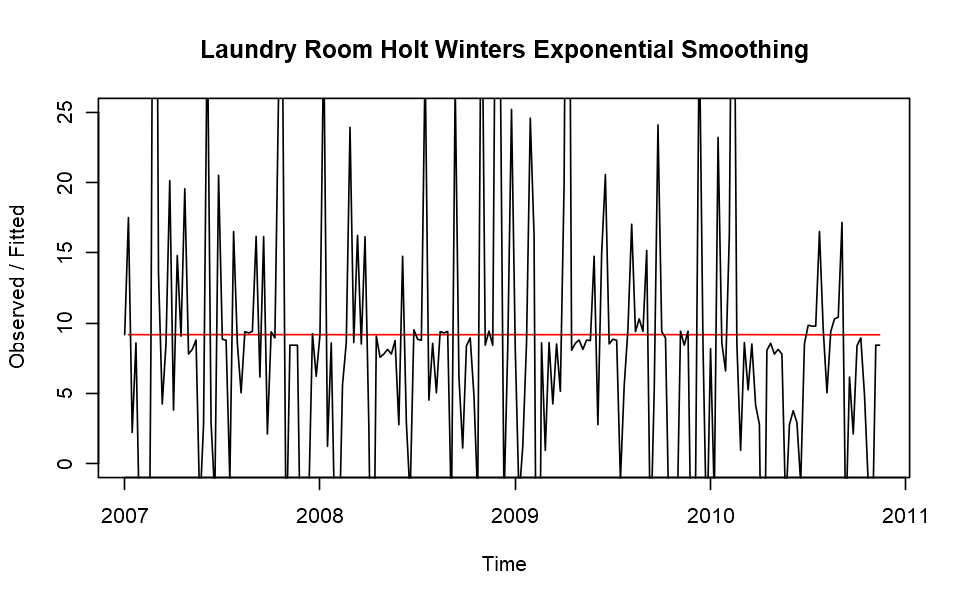

In [57]:
tsSM2_HW <- HoltWinters(tsSM2_Adjusted, beta=FALSE, gamma=FALSE)
plot(tsSM2_HW, ylim = c(0, 25), main ="Laundry Room Holt Winters Exponential Smoothing")

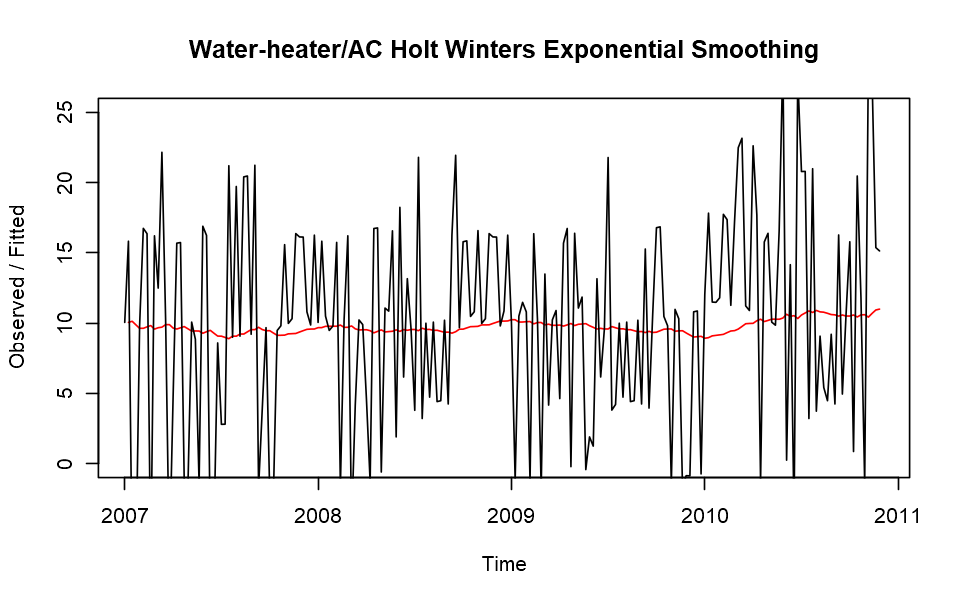

In [59]:
tsSM3_HW <- HoltWinters(tsSM3_Adjusted, beta=FALSE, gamma=FALSE)
plot(tsSM3_HW, ylim = c(0, 25), main ="Water-heater/AC Holt Winters Exponential Smoothing")

After removing seasonal component, the fitted lines do not fluctuate much. Laundry room exponential smoothing shows a straight fitted line, whereas kitchen exponential smoothing line has more fluctuations with a peak in spring 2008. 

#### 3.3.2 Holt-Winters Forecast

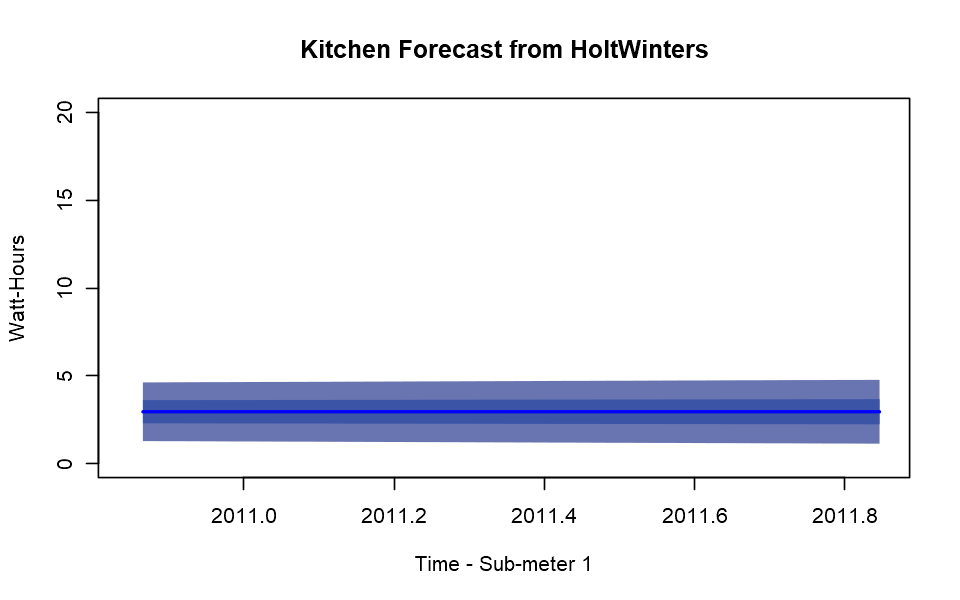

In [72]:
## Forecast HoltWinters with diminished confidence levels
tsSM1_HWforC <- forecast(tsSM1_HW, h=52, level=c(10,25))
## Plot only the forecasted area
plot(tsSM1_HWforC, ylim = c(0, 20), ylab= "Watt-Hours", xlab="Time - Sub-meter 1", start(2010),main="Kitchen Forecast from HoltWinters")

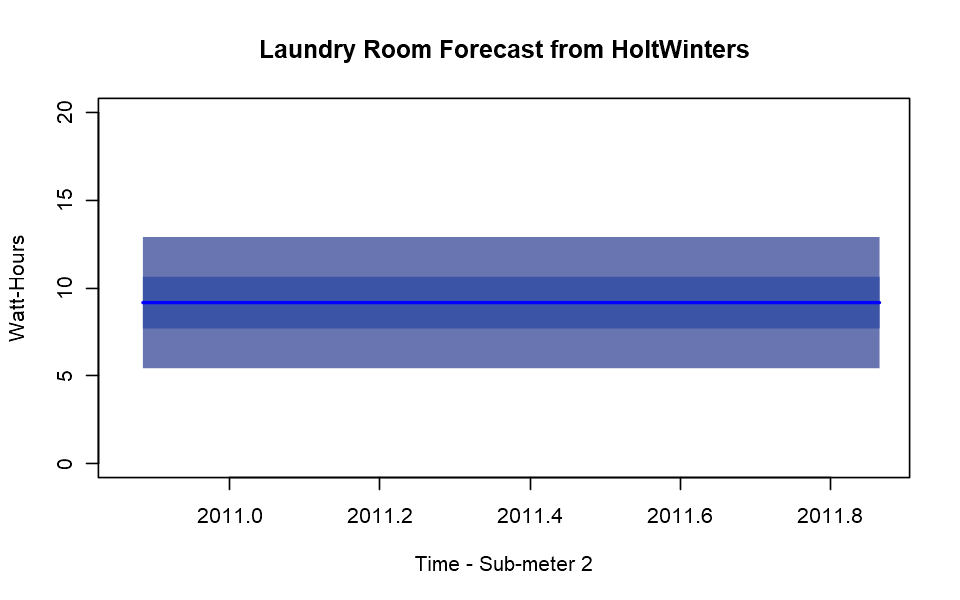

In [73]:
## Forecast HoltWinters with diminished confidence levels
tsSM2_HWforC <- forecast(tsSM2_HW, h=52, level=c(10,25))
plot(tsSM2_HWforC, ylim = c(0, 20), ylab= "Watt-Hours", xlab="Time - Sub-meter 2", start(2010),main="Laundry Room Forecast from HoltWinters")

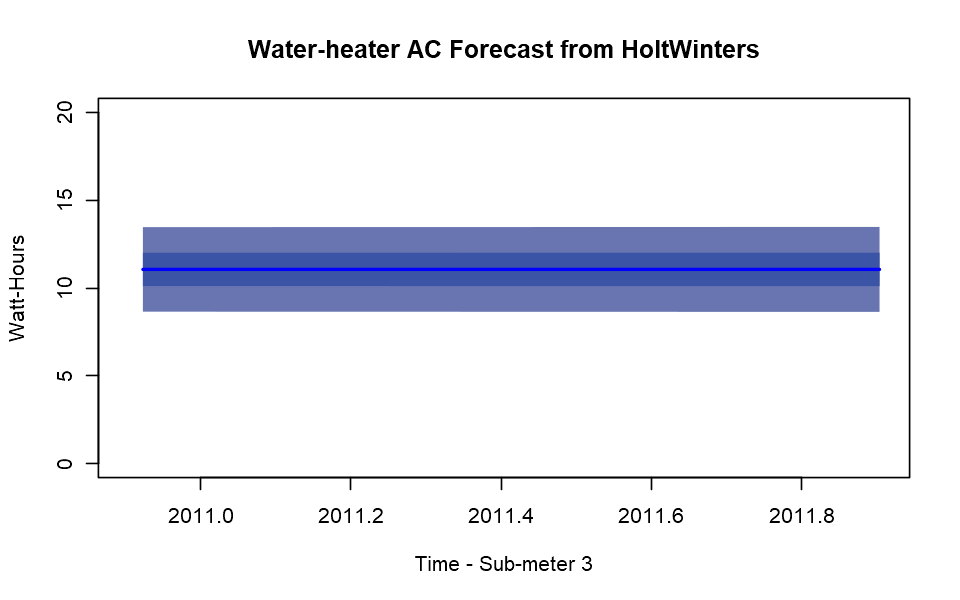

In [74]:
## Forecast HoltWinters with diminished confidence levels
tsSM3_HWforC <- forecast(tsSM3_HW, h=52, level=c(10,25))
plot(tsSM3_HWforC, ylim = c(0, 20), ylab= "Watt-Hours", xlab="Time - Sub-meter 3", start(2010),main="Water-heater AC Forecast from HoltWinters")

When we remove seasonality from historical data, we can see that the forecasts are straight lines for all three sub-meterings, and the predicted power consumption of laudry room and water-heater/AC are twice more than kitchen usage, which matches the exponential smoothing fitted lines of the past years.
<br/><br/> 
It indicates that without seasonal factor, the energy consumptions in households are pretty much constant, but people do use more energy in the laundry room, water-heater and AC than in the kitchen.    

## 4. Recommendations For Smart Home Builders

- ##### Sub-metering devices: 
Devices should be recommended to home owners to always be used as they provide detailed and valuable data on power consumption.
<br/>
- ##### Kitchen:
Install appliances that have high efficiency and lower watt/hour usage.
<br/>
- ##### Laundry Room:
Use high efficiency washer and dryer, and perform larger loads with less frequency.
<br/>
- ##### Water Heater:
Install on demand water heater to reduce contant usage.
<br/>
- ##### AC:
Install smart thermostat, and use scheduling to turn off when away from home.
<br/>
- ##### Lighting:
Home lighting power consumption should be included in data analysis to provide thorough usage reporting.
